# Tracking synapses


In [1]:
import time

import numpy as np

from caveclient import CAVEclient
from paleo import (
    get_initial_graph,
    get_root_level2_edits,
    get_nucleus_supervoxel,
    get_node_aliases,
)

In [3]:
root_id = 864691135639556411
client = CAVEclient("minnie65_public", version=1078)

## Collect edit history information


In [4]:
edits = get_root_level2_edits(root_id, client)
initial_graph = get_initial_graph(root_id, client)
nuc_supervoxel_id = get_nucleus_supervoxel(root_id, client)
node_info = get_node_aliases(nuc_supervoxel_id, client, stop_layer=2)
anchor_nodes = node_info.index

Extracting level2 edits:   0%|          | 0/693 [00:00<?, ?it/s]

/Users/ben.pedigo/code/cave-edits/paleo/.venv/lib/python3.12/site-packages/networkx/readwrite/json_graph/node_link.py:287: FutureWarning: 
The default value will be changed to `edges="edges" in NetworkX 3.6.

To make this warning go away, explicitly set the edges kwarg, e.g.:

  nx.node_link_graph(data, edges="links") to preserve current behavior, or
  nx.node_link_graph(data, edges="edges") for forward compatibility.
  warnings.warn(


Getting initial graph:   0%|          | 0/309 [00:00<?, ?it/s]

## Get synapses


In [10]:
from paleo import get_all_time_synapses

currtime = time.time()
pre_synapses, post_synapses = get_all_time_synapses(root_id, client, verbose=True)
print(f"{time.time() - currtime:.3f} seconds elapsed.")

/Users/ben.pedigo/code/cave-edits/paleo/.venv/lib/python3.12/site-packages/networkx/readwrite/json_graph/node_link.py:287: FutureWarning: 
The default value will be changed to `edges="edges" in NetworkX 3.6.

To make this warning go away, explicitly set the edges kwarg, e.g.:

  nx.node_link_graph(data, edges="links") to preserve current behavior, or
  nx.node_link_graph(data, edges="edges") for forward compatibility.
  warnings.warn(


Getting original roots took 22.15 seconds
Getting latest roots took 5.95 seconds
Querying synapse table for pre-synapses...
Querying synapse table took 62.06 seconds
Querying synapse table for post-synapses...
Querying synapse table took 271.22 seconds


## Apply edit history


In [109]:
from paleo import apply_edit_sequence

components = apply_edit_sequence(
    initial_graph,
    edits,
    anchor_nodes,
    return_graphs=False,
    include_initial=True,
    verbose=True,
)
components

  0%|          | 0/694 [00:00<?, ?it/s]

{-1: {161373192110212021,
  161373192177319957,
  161373260829688894,
  161373260896796674,
  161373329549165526,
  161373329616273411,
  161373398335750279,
  161443492202020923,
  161443560854389734,
  161443560921497602,
  161443629573866365,
  161443629640974337,
  161443698293343195,
  161443698360451073,
  161443767079927917,
  161513860946198532,
  161513929598567394,
  161513929665675266,
  161513929665675274,
  161513998318044173,
  161513998385152001,
  161514067037520900,
  161514067104628737,
  161514135824105588,
  161514135824105609,
  161584229690376221,
  161584298342745132,
  161584298409852931,
  161584367062221750,
  161584367129329665,
  161584435781698483,
  161584435848806401,
  161584435848806430,
  161654598434553982,
  161654667154030620,
  161654735806399337,
  161654735873507331,
  161654804592984109},
 9028: {161373192110212021,
  161373192177319957,
  161373260829688894,
  161373260896796674,
  161373329549165526,
  161373329616273411,
  161373398335750279,

## Map synapses to state history


In [79]:
from paleo import get_supervoxel_mappings

currtime = time.time()

pre_supervoxel_ids = pre_synapses["pre_pt_supervoxel_id"].unique()
post_supervoxel_ids = post_synapses["post_pt_supervoxel_id"].unique()

supervoxel_ids = np.unique(np.concatenate([pre_supervoxel_ids, post_supervoxel_ids]))
supervoxel_mappings = get_supervoxel_mappings(supervoxel_ids, edits, client)

print(f"{time.time() - currtime:.3f} seconds elapsed.")

Getting leaves:   0%|          | 0/3046 [00:00<?, ?it/s]

Getting remaining level2s:   0%|          | 0/25 [00:00<?, ?it/s]

In [85]:
supervoxel_mappings

76227561277173341     [148285155314762432]
76227629996665354     [148285224034239113]
76297930021333702     [148355524058940011]
76297930021338269     [148355524058940011]
76297930021390513     [148355524058940126]
                              ...         
117464332828678017    [189521926866076233]
117534632920072581    [189592226957885488]
117674889372423565    [189732483409904440]
117675026811293126    [189732620848857604]
117675988816998415    [189733582854423388]
Length: 254222, dtype: object

In [ ]:
supervoxel_mappings[77501276845337086]

In [93]:
pre_synapses["pre_pt_level2_ids"] = pre_synapses["pre_pt_supervoxel_id"].map(
    supervoxel_mappings
)
pre_synapses = pre_synapses.explode("pre_pt_level2_ids")

In [102]:
pre_synapses = pre_synapses.reset_index(drop=False).set_index("pre_pt_level2_ids")

synapse_ids_by_edit = []
for component in tqdm(components):
    component_synapse_index = pre_synapses.index.intersection(list(component))
    synapse_ids_at_state = pre_synapses.loc[component_synapse_index, "id"].unique()
    synapse_ids_by_edit.append(synapse_ids_at_state)

100%|██████████| 694/694 [00:21<00:00, 31.74it/s]


## Plot number of synapses over time


In [103]:
n_synapses = [len(s) for s in synapse_ids_by_edit]

Text(0, 0.5, 'Number of pre-synapses')

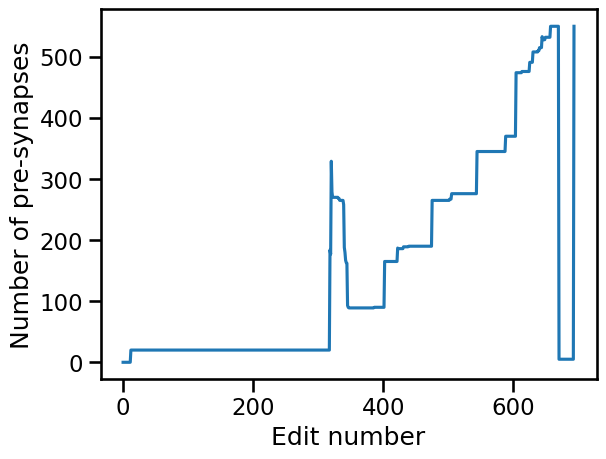

In [106]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_context("talk")

fig, ax = plt.subplots()
sns.lineplot(x=range(len(n_synapses)), y=n_synapses, ax=ax)
ax.set_xlabel("Edit number")
ax.set_ylabel("Number of pre-synapses")